## Parkinson Disease

# Parkinson Disease is a brain neurological disorder. It leads to shaking of the body, hands and provides stiffness to the body. No proper cure or treatment is available yet at the advanced stage. Treatment is possible only when done at the early or onset of the disease. These will not only reduce the cost of the disease but will also possibly save a life.

## IMPORTING THE DEPENDENCES

In [1]:
import pandas as pd 
import numpy as np
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
import matplotlib.pyplot as plt
%matplotlib inline

## DATA COLLECTION AND ANALYSIS(LOADING DATA)

In [61]:
df=pd.read_csv("parkinsons.data")
df

,name,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
0,phon_R01_S01_1,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,...,0.06545,0.02211,21.033,1,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,phon_R01_S01_2,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,...,0.09403,0.01929,19.085,1,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,phon_R01_S01_3,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,...,0.08270,0.01309,20.651,1,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,phon_R01_S01_4,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,...,0.08771,0.01353,20.644,1,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,phon_R01_S01_5,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,...,0.10470,0.01767,19.649,1,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,phon_R01_S50_2,174.188,230.978,94.261,0.00459,0.00003,0.00263,0.00259,0.00790,0.04087,...,0.07008,0.02764,19.517,0,0.448439,0.657899,-6.538586,0.121952,2.657476,0.133050
191,phon_R01_S50_3,209.516,253.017,89.488,0.00564,0.00003,0.00331,0.00292,0.00994,0.02751,...,0.04812,0.01810,19.147,0,0.431674,0.683244,-6.195325,0.129303,2.784312,0.168895
192,phon_R01_S50_4,174.688,240.005,74.287,0.01360,0.00008,0.00624,0.00564,0.01873,0.02308,...,0.03804,0.10715,17.883,0,0.407567,0.655683,-6.787197,0.158453,2.679772,0.131728
193,phon_R01_S50_5,198.764,396.961,74.904,0.00740,0.00004,0.00370,0.00390,0.01109,0.02296,...,0.03794,0.07223,19.020,0,0.451221,0.643956,-6.744577,0.207454,2.138608,0.123306


# The data set has 195 samples. Each row of the data set consists of voice recording of individuals with name and 23 attributes of biomedical voice measurements. The main aim of the data is to discriminate healthy people from those with Parkinson's Disease, according to "status" column which is set to `0` for healthy and `1` for individual affected with Parkinson's Disease.



In [3]:
df[50:60]

,name,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
50,phon_R01_S13_3,124.445,135.069,117.495,0.00431,0.00003,0.00141,0.00167,0.00422,0.02184,...,0.03724,0.00479,25.135,0,0.553134,0.775933,-6.650471,0.254498,1.840198,0.103561
51,phon_R01_S13_4,126.344,134.231,112.773,0.00448,0.00004,0.00131,0.00169,0.00393,0.02033,...,0.03429,0.00474,25.030,0,0.507504,0.760361,-6.689151,0.291954,2.431854,0.105993
52,phon_R01_S13_5,128.001,138.052,122.080,0.00436,0.00003,0.00137,0.00166,0.00411,0.02297,...,0.03969,0.00481,24.692,0,0.459766,0.766204,-7.072419,0.220434,1.972297,0.119308
53,phon_R01_S13_6,129.336,139.867,118.604,0.00490,0.00004,0.00165,0.00183,0.00495,0.02498,...,0.04188,0.00484,25.429,0,0.420383,0.785714,-6.836811,0.269866,2.223719,0.147491
54,phon_R01_S16_1,108.807,134.656,102.874,0.00761,0.00007,0.00349,0.00486,0.01046,0.02719,...,0.04450,0.01036,21.028,1,0.536009,0.819032,-4.649573,0.205558,1.986899,0.316700
55,phon_R01_S16_2,109.860,126.358,104.437,0.00874,0.00008,0.00398,0.00539,0.01193,0.03209,...,0.05368,0.01180,20.767,1,0.558586,0.811843,-4.333543,0.221727,2.014606,0.344834
56,phon_R01_S16_3,110.417,131.067,103.370,0.00784,0.00007,0.00352,0.00514,0.01056,0.03715,...,0.06097,0.00969,21.422,1,0.541781,0.821364,-4.438453,0.238298,1.922940,0.335041
57,phon_R01_S16_4,117.274,129.916,110.402,0.00752,0.00006,0.00299,0.00469,0.00898,0.02293,...,0.03568,0.00681,22.817,1,0.530529,0.817756,-4.608260,0.290024,2.021591,0.314464
58,phon_R01_S16_5,116.879,131.897,108.153,0.00788,0.00007,0.00334,0.00493,0.01003,0.02645,...,0.04183,0.00786,22.603,1,0.540049,0.813432,-4.476755,0.262633,1.827012,0.326197
59,phon_R01_S16_6,114.847,271.314,104.680,0.00867,0.00008,0.00373,0.00520,0.01120,0.03225,...,0.05414,0.01143,21.660,1,0.547975,0.817396,-4.609161,0.221711,1.831691,0.316395


In [4]:
df.shape # NUMBERS OF ROWS AND COLUMNS

(195, 24)

In [5]:
df.info() # GETTING MORE INFORMATION ON THE DATASET

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 195 entries, 0 to 194
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   name              195 non-null    object 
 1   MDVP:Fo(Hz)       195 non-null    float64
 2   MDVP:Fhi(Hz)      195 non-null    float64
 3   MDVP:Flo(Hz)      195 non-null    float64
 4   MDVP:Jitter(%)    195 non-null    float64
 5   MDVP:Jitter(Abs)  195 non-null    float64
 6   MDVP:RAP          195 non-null    float64
 7   MDVP:PPQ          195 non-null    float64
 8   Jitter:DDP        195 non-null    float64
 9   MDVP:Shimmer      195 non-null    float64
 10  MDVP:Shimmer(dB)  195 non-null    float64
 11  Shimmer:APQ3      195 non-null    float64
 12  Shimmer:APQ5      195 non-null    float64
 13  MDVP:APQ          195 non-null    float64
 14  Shimmer:DDA       195 non-null    float64
 15  NHR               195 non-null    float64
 16  HNR               195 non-null    float64
 1

In [6]:
df.describe() # getting statistical measures about the dataset

,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
count,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,...,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000
mean,154.228641,197.104918,116.324631,0.006220,0.000044,0.003306,0.003446,0.009920,0.029709,0.282251,...,0.046993,0.024847,21.885974,0.753846,0.498536,0.718099,-5.684397,0.226510,2.381826,0.206552
std,41.390065,91.491548,43.521413,0.004848,0.000035,0.002968,0.002759,0.008903,0.018857,0.194877,...,0.030459,0.040418,4.425764,0.431878,0.103942,0.055336,1.090208,0.083406,0.382799,0.090119
min,88.333000,102.145000,65.476000,0.001680,0.000007,0.000680,0.000920,0.002040,0.009540,0.085000,...,0.013640,0.000650,8.441000,0.000000,0.256570,0.574282,-7.964984,0.006274,1.423287,0.044539
25%,117.572000,134.862500,84.291000,0.003460,0.000020,0.001660,0.001860,0.004985,0.016505,0.148500,...,0.024735,0.005925,19.198000,1.000000,0.421306,0.674758,-6.450096,0.174351,2.099125,0.137451
50%,148.790000,175.829000,104.315000,0.004940,0.000030,0.002500,0.002690,0.007490,0.022970,0.221000,...,0.038360,0.011660,22.085000,1.000000,0.495954,0.722254,-5.720868,0.218885,2.361532,0.194052
75%,182.769000,224.205500,140.018500,0.007365,0.000060,0.003835,0.003955,0.011505,0.037885,0.350000,...,0.060795,0.025640,25.075500,1.000000,0.587562,0.761881,-5.046192,0.279234,2.636456,0.252980
max,260.105000,592.030000,239.170000,0.033160,0.000260,0.021440,0.019580,0.064330,0.119080,1.302000,...,0.169420,0.314820,33.047000,1.000000,0.685151,0.825288,-2.434031,0.450493,3.671155,0.527367


In [7]:
df.columns

Index(['name', 'MDVP:Fo(Hz)', 'MDVP:Fhi(Hz)', 'MDVP:Flo(Hz)', 'MDVP:Jitter(%)',
       'MDVP:Jitter(Abs)', 'MDVP:RAP', 'MDVP:PPQ', 'Jitter:DDP',
       'MDVP:Shimmer', 'MDVP:Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5',
       'MDVP:APQ', 'Shimmer:DDA', 'NHR', 'HNR', 'status', 'RPDE', 'DFA',
       'spread1', 'spread2', 'D2', 'PPE'],
      dtype='object')

In [8]:
df['status'].value_counts() # distribution of targrt variable

1    147
0     48
Name: status, dtype: int64

In [9]:
df.groupby('status').mean() # grouping the data base on the target variable


,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),...,MDVP:APQ,Shimmer:DDA,NHR,HNR,RPDE,DFA,spread1,spread2,D2,PPE
status,,,,,,,,,,,,,,,,,,,,,
0,181.937771,223.636750,145.207292,0.003866,0.000023,0.001925,0.002056,0.005776,0.017615,0.162958,...,0.013305,0.028511,0.011483,24.678750,0.442552,0.695716,-6.759264,0.160292,2.154491,0.123017
1,145.180762,188.441463,106.893558,0.006989,0.000051,0.003757,0.003900,0.011273,0.033658,0.321204,...,0.027600,0.053027,0.029211,20.974048,0.516816,0.725408,-5.333420,0.248133,2.456058,0.233828


## VISUALIZATION

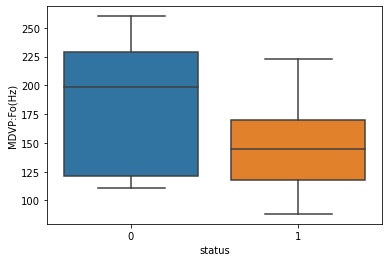

In [10]:
sns.boxplot(x ="status", y="MDVP:Fo(Hz)", data = df);

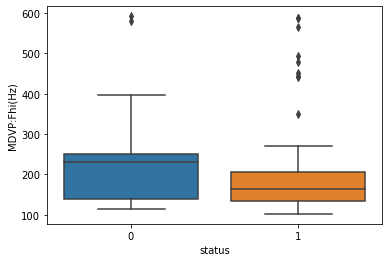

In [11]:
sns.boxplot(x ="status", y="MDVP:Fhi(Hz)", data = df);

<AxesSubplot:xlabel='status', ylabel='MDVP:Flo(Hz)'>

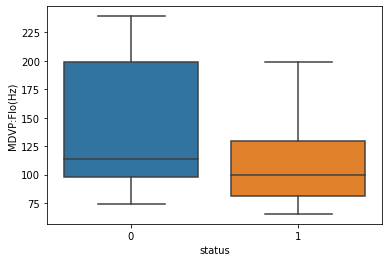

In [12]:
sns.boxplot(x='status',y='MDVP:Flo(Hz)',data=df)

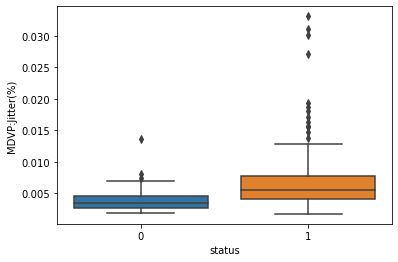

In [13]:
sns.boxplot(x='status',y='MDVP:Jitter(%)',data=df);

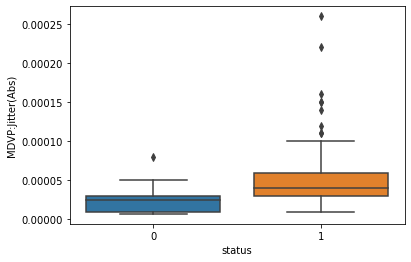

In [14]:
sns.boxplot(x='status',y='MDVP:Jitter(Abs)',data=df);

<AxesSubplot:xlabel='status', ylabel='Jitter:DDP'>

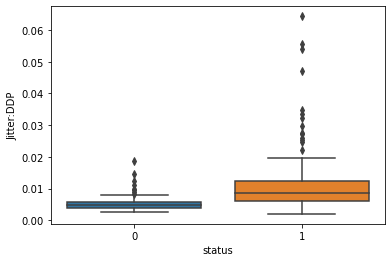

In [15]:
sns.boxplot(x='status',y='Jitter:DDP',data=df)

<AxesSubplot:xlabel='status', ylabel='MDVP:RAP'>

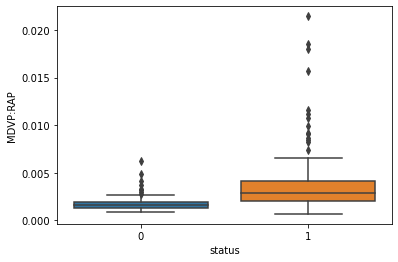

In [16]:
sns.boxplot(x='status',y='MDVP:RAP',data=df)

<AxesSubplot:xlabel='status', ylabel='MDVP:PPQ'>

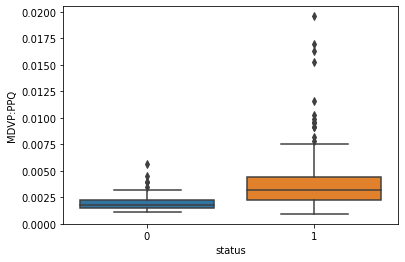

In [17]:
sns.boxplot(x='status',y='MDVP:PPQ',data=df)

<AxesSubplot:xlabel='status', ylabel='Shimmer:DDA'>

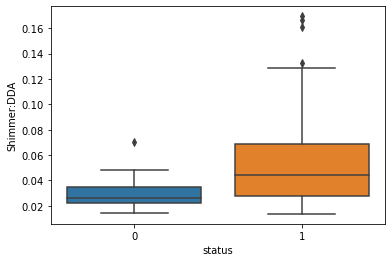

In [18]:
sns.boxplot(x='status',y='Shimmer:DDA',data=df)

<AxesSubplot:xlabel='status', ylabel='MDVP:Shimmer'>

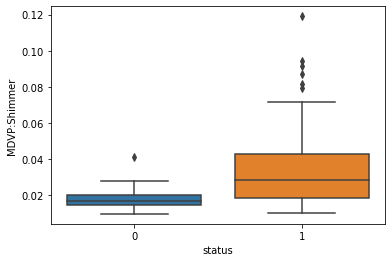

In [19]:
sns.boxplot(x='status',y='MDVP:Shimmer',data=df)

<AxesSubplot:xlabel='status', ylabel='MDVP:Shimmer(dB)'>

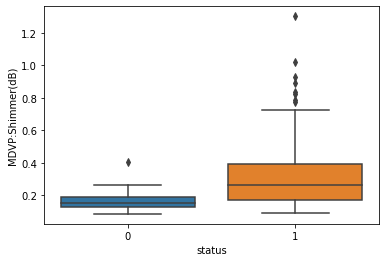

In [20]:
sns.boxplot(x='status',y='MDVP:Shimmer(dB)',data=df)#

<AxesSubplot:xlabel='status', ylabel='Shimmer:APQ3'>

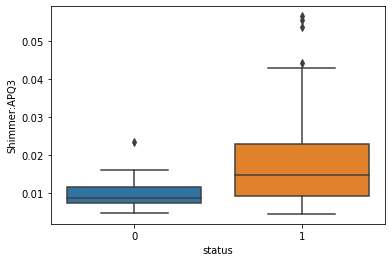

In [21]:
sns.boxplot(x='status',y='Shimmer:APQ3',data=df)

<AxesSubplot:xlabel='status', ylabel='Shimmer:APQ5'>

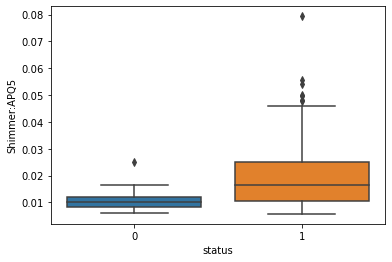

In [22]:
sns.boxplot(x='status',y='Shimmer:APQ5',data=df)

<AxesSubplot:xlabel='status', ylabel='MDVP:APQ'>

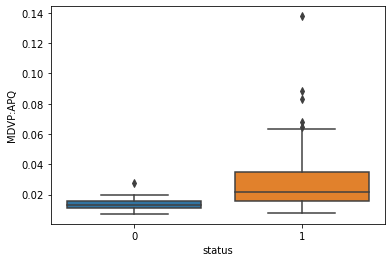

In [23]:
sns.boxplot(x='status',y='MDVP:APQ',data=df)

<AxesSubplot:xlabel='status', ylabel='NHR'>

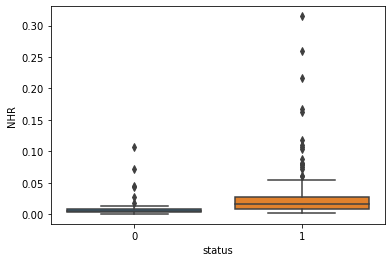

In [24]:
sns.boxplot(x='status',y='NHR',data=df)

<AxesSubplot:xlabel='status', ylabel='HNR'>

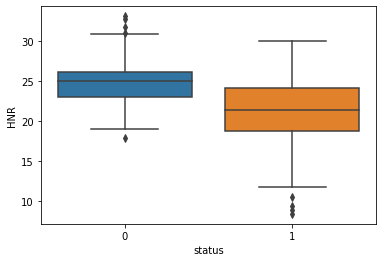

In [25]:
sns.boxplot(x='status',y='HNR',data=df)

<AxesSubplot:xlabel='status', ylabel='RPDE'>

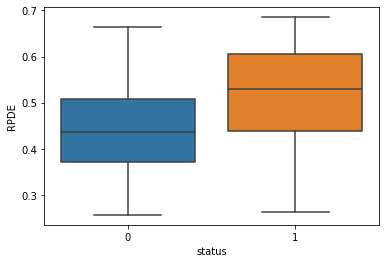

In [26]:
sns.boxplot(x='status',y='RPDE',data=df)

<AxesSubplot:xlabel='status', ylabel='DFA'>

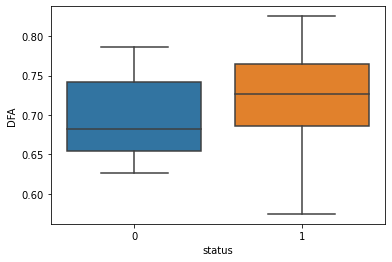

In [27]:
sns.boxplot(x='status',y='DFA',data=df)

<AxesSubplot:xlabel='status', ylabel='spread1'>

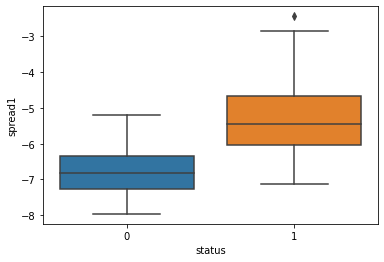

In [28]:
sns.boxplot(x='status',y='spread1',data=df)

<AxesSubplot:xlabel='status', ylabel='spread2'>

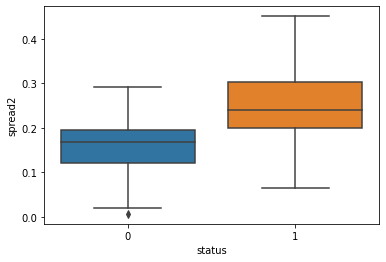

In [29]:
sns.boxplot(x='status',y='spread2',data=df)

<AxesSubplot:xlabel='status', ylabel='D2'>

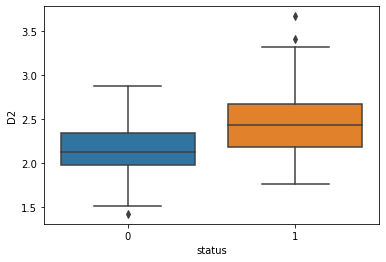

In [30]:
sns.boxplot(x='status',y='D2',data=df)

<AxesSubplot:xlabel='status', ylabel='PPE'>

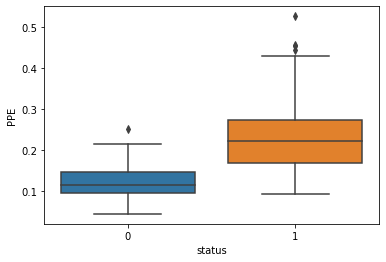

In [31]:
sns.boxplot(x='status',y='PPE',data=df)

In [32]:
from pandas_profiling import ProfileReport
df.profile_report()

## DATA PRE-PROCESSING
# separating features from target

In [33]:
X=df.drop(['status','name'],axis=1)
y=df.status
X

,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),...,MDVP:APQ,Shimmer:DDA,NHR,HNR,RPDE,DFA,spread1,spread2,D2,PPE
0,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,0.426,...,0.02971,0.06545,0.02211,21.033,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,0.626,...,0.04368,0.09403,0.01929,19.085,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,0.482,...,0.03590,0.08270,0.01309,20.651,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,0.517,...,0.03772,0.08771,0.01353,20.644,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,0.584,...,0.04465,0.10470,0.01767,19.649,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,174.188,230.978,94.261,0.00459,0.00003,0.00263,0.00259,0.00790,0.04087,0.405,...,0.02745,0.07008,0.02764,19.517,0.448439,0.657899,-6.538586,0.121952,2.657476,0.133050
191,209.516,253.017,89.488,0.00564,0.00003,0.00331,0.00292,0.00994,0.02751,0.263,...,0.01879,0.04812,0.01810,19.147,0.431674,0.683244,-6.195325,0.129303,2.784312,0.168895
192,174.688,240.005,74.287,0.01360,0.00008,0.00624,0.00564,0.01873,0.02308,0.256,...,0.01667,0.03804,0.10715,17.883,0.407567,0.655683,-6.787197,0.158453,2.679772,0.131728
193,198.764,396.961,74.904,0.00740,0.00004,0.00370,0.00390,0.01109,0.02296,0.241,...,0.01588,0.03794,0.07223,19.020,0.451221,0.643956,-6.744577,0.207454,2.138608,0.123306


In [34]:
y

0      1
1      1
2      1
3      1
4      1
      ..
190    0
191    0
192    0
193    0
194    0
Name: status, Length: 195, dtype: int64

## SPLITTING THE DATA TO TRAINING DATA AND TEST DATA

In [35]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
scaler

MinMaxScaler()

In [36]:
features= df.drop(['status','name'],axis=1)
X = scaler.fit_transform(features)
y=df.status
X
#y

array([[0.18430827, 0.11259173, 0.05481479, ..., 0.58576513, 0.39066128,
        0.4973096 ],
       [0.19832685, 0.09493044, 0.2783228 , ..., 0.74133704, 0.47314522,
        0.67132602],
       [0.16503854, 0.05912816, 0.26528838, ..., 0.68637091, 0.40881938,
        0.59668246],
       ...,
       [0.50273036, 0.28141298, 0.05072714, ..., 0.34257652, 0.55896743,
        0.18057983],
       [0.6428929 , 0.60180655, 0.05427936, ..., 0.45288473, 0.31822198,
        0.16313677],
       [0.73327434, 0.32279413, 0.07194837, ..., 0.41509481, 0.50367281,
        0.21545975]])

In [37]:
from sklearn import metrics
from sklearn.model_selection import train_test_split


X_train, X_test, y_train, y_test = train_test_split(X,y,train_size=0.8,random_state=42)

In [38]:
len(X_train)

156

In [39]:
len(X_test)

39

In [40]:
from sklearn.linear_model import LogisticRegression
model=LogisticRegression()

In [41]:
model.fit(X_train,y_train) #fit method is used to train the dataset

LogisticRegression()

In [42]:
y_predicted = model.predict(X_test)

In [43]:
model.predict_proba(X_test)

array([[0.05812358, 0.94187642],
       [0.25929781, 0.74070219],
       [0.08719935, 0.91280065],
       [0.26534472, 0.73465528],
       [0.10225293, 0.89774707],
       [0.15911886, 0.84088114],
       [0.04645792, 0.95354208],
       [0.25320807, 0.74679193],
       [0.22771664, 0.77228336],
       [0.47032228, 0.52967772],
       [0.20837571, 0.79162429],
       [0.01406887, 0.98593113],
       [0.08072378, 0.91927622],
       [0.04570133, 0.95429867],
       [0.02006703, 0.97993297],
       [0.12641227, 0.87358773],
       [0.15039594, 0.84960406],
       [0.37934203, 0.62065797],
       [0.26492118, 0.73507882],
       [0.24440604, 0.75559396],
       [0.20392411, 0.79607589],
       [0.41555988, 0.58444012],
       [0.09315906, 0.90684094],
       [0.79574076, 0.20425924],
       [0.08113001, 0.91886999],
       [0.15872521, 0.84127479],
       [0.09770294, 0.90229706],
       [0.13662504, 0.86337496],
       [0.72024687, 0.27975313],
       [0.01518979, 0.98481021],
       [0.

In [44]:
from sklearn import metrics

In [45]:
metrics.f1_score(y_test,y_predicted)

0.9411764705882353

In [46]:
metrics.accuracy_score(y_test,y_predicted)

0.8974358974358975

# SVM(Support Vector Machine) is a statistical machine learning framework that uses support vectors to classify new data points. The kernel trick can be used by SVM for feature engineering which makes is very powerful tool for supervised learning.

# Image classification and hand-written recognition are where the support vector machine comes to hand used. It sorts the data in one out of two categories and displays the output with the margin between the two as far as possible.

## MODEL TRAINING

In [47]:
from sklearn.svm import SVC
model= SVC(kernel='rbf',random_state=42)

In [48]:
model.fit(X_train,y_train)

SVC(random_state=42)

In [49]:
y_prediction= model.predict(X_test)
#y_prediction

In [50]:
metrics.f1_score(y_test,y_prediction)

0.9411764705882353

In [51]:
model_= SVC()
model_.fit(X_train,y_train)

SVC()

In [52]:
ypredicted = model_.predict(X_test)
ypredicted

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], dtype=int64)

In [53]:
metrics.f1_score(y_test,ypredicted)

0.9411764705882353

## Tuning parameters

In [54]:
_model_=SVC(kernel='rbf',gamma='auto', C=10, degree=3)
_model_.fit(X_train,y_train)
_model_.score(X_test,y_test)
ypredicted=_model_.predict(X_test)

In [55]:
metrics.accuracy_score(y_test,ypredicted)

0.8974358974358975

In [56]:
metrics.f1_score(y_test,ypredicted)

0.9411764705882353

In [57]:
model_l=SVC(kernel='linear',gamma="scale", C=10, degree=3)
model_l.fit(X_train,y_train)
model_l.score(X_test,y_test)
ypredicted_=model_l.predict(X_test)

In [59]:
metrics.accuracy_score(y_test,ypredicted)

0.8974358974358975

In [60]:
metrics.f1_score(y_test,ypredicted_)

0.955223880597015

## To detect the presence of Parkinson’s Disease in individuals using various factors. We used SVM(SUPPORT VECTOR MACHINE) for this and made use of the sklearn library to prepare the dataset. This gives us an accuracy of 0.955%.

# This model is  useful to  health and medical instutite, Research Networking Center on Neurodegenerative Diseases .